In [1]:
!pip install --quiet pytorch-lightning
!pip install --quiet seaborn

     |████████████████████████████████| 701 kB 8.0 MB/s 
     |████████████████████████████████| 596 kB 60.2 MB/s 
     |████████████████████████████████| 5.9 MB 52.7 MB/s 
     |████████████████████████████████| 141 kB 54.2 MB/s 
     |████████████████████████████████| 419 kB 79.7 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.2+zzzcolab20220719082949 requires tensorboard<2.9,>=2.8, but you have tensorboard 2.10.0 which is incompatible.


In [3]:
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import json
import plotly.graph_objects as go
import pandas as pd
import torch
import pytorch_lightning as pl
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedShuffleSplit
from tqdm import tqdm
from IPython.display import HTML
from sklearn.preprocessing import LabelEncoder
from os import cpu_count, environ

import torch.autograd as autograd
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.nn.modules import dropout

from multiprocessing import cpu_count
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping
from pytorch_lightning.loggers import TensorBoardLogger
from torchmetrics.functional import accuracy
from sklearn.metrics import classification_report, confusion_matrix


pl.seed_everything(42)

float_formatter = "{:.8f}".format
np.set_printoptions(formatter={'float_kind':float_formatter})


def print_yellow(text): print("\033[93m {}\033[00m".format(text))


def print_bold(text): print(f"\033[1m {text} \033[0m")


def read_json(path):
  with open(path, 'r') as file_in:
     return json.load(file_in)


def max_listoflists_lenght(l, verbose=False):
  """l is a list of lists"""
  max_lenght = 0
  for i in l:
    if max_lenght < len(i):
      max_lenght = len(i)
  if verbose:
    print("min_lenght: ", min_listoflists_lenght(l))
    print("max_lenght: ", max_lenght)
  return max_lenght


def min_listoflists_lenght(l):
  """l is a list of lists"""
  min_lenght = 999999
  for i in l:
    if min_lenght > len(i):
      min_lenght = len(i)
  return min_lenght


def normalize(l, verbose=False):
  l = (l - np.mean(l)) / np.std(l)
  l = [i.tolist() for i in l]
  if verbose:
    print("max: ", max(l))
    print("mean: ", np.mean(l))
    print("std: ", np.std(l))
  return l


def normalize_lenghts(l, verbose=False, max_lenght=0):
  """l is a list of lists"""
  if max_lenght==0:
    max_lenght = max_listoflists_lenght(l, verbose)
  print("max_lenght: ", max_lenght)
  new_l = [np.interp(np.linspace(0, 1, max_lenght).astype('float'), np.linspace(0, 1, len(l_i)).astype('float'), l_i) for l_i in l]
  if verbose:
    min_listoflists_lenght(l)
  return new_l


def normalize_single_lenght(l, max_lenght=0):
  """l is a list"""
  if max_lenght==0:
    max_lenght = max([len(i) for i in l])
  print("max_lenght: ", max_lenght)
  new_l = np.interp(np.linspace(0, 1, max_lenght).astype('float'), np.linspace(0, 1, len(l)).astype('float'), l)
  return new_l


def add_pattern_name_to_ts(distance_ts, pupil_ts):
  new_pupil_ts = []
  for distance, pupil in zip(distance_ts, pupil_ts):
    pattern_name, _ = distance
    new_pupil_ts.append([pattern_name, pupil])
  return new_pupil_ts


def get_distance_in_dataframe(df, user_name):
  is_user = df['participant_name'] == user_name
  df = df[is_user]
  distance_collection = []
  
  for ix, sample in df.iterrows():
    distance_collection.append([sample['pattern_name'], sample['ts_distance'].tolist()])

  return distance_collection


def get_pupil_in_dataframe(df, user_name):
  is_user = df['participant_name'] == user_name
  df = df[is_user]
  pupil_collection = []

  for ix, sample in df.iterrows():
    pupil_collection.append([sample['pattern_name'], sample['ts_pupil'].tolist()])

  return pupil_collection 
  

def plot_collection(plot_only_this:str, distances_collection,
                    number_of_desired_plots=0):
  
  """this method takes the distances_collection for one user and a specific 
      pattern plot_only_this and add traces in the same graph until the 
      number_of_desired_plots is reached; if 0 then plot all"""

      # todo: there is a lot of redundancy, you could clear a lot of lines

  fig = go.Figure()
  plots_count = 0
  print("total number of graphs: ", len(distances_collection))

  for (pattern_name, d) in distances_collection:
    if pattern_name == plot_only_this:
      if plots_count ==0:
        fig.add_trace(go.Line(y=d))
        fig.update_layout(title=plot_only_this)
      else:
        fig.add_trace(go.Line(y=d))
      plots_count += 1
      fig.update_layout(width=1200, height=800)
      if number_of_desired_plots:
        if plots_count == number_of_desired_plots:
          break

  print("plots: ", plots_count)
  return fig


def plot_experiment(name:str, l, normal=False, normal_only=False, stretched=False, max_lenght=0, verbose=False):
  if verbose:
    print("raw: ")
    print("max: ", max(l))
    print("mean: ", np.mean(l))
    print("std: ", np.std(l), end="\n\n")
    
  fig = go.Figure()
  fig.update_layout(title=name)
  fig.update_layout(width=1200, height=800)
  if not normal_only:
    fig.add_trace(go.Line(name="raw", y=l))

  if normal:
    l_normal = normalize(l, verbose=verbose)
    fig.add_trace(go.Line(name="nomalized_value", y=l_normal))

  if stretched:
    if max_lenght!=0:
      l_normal = normalize_single_lenght(l, max_lenght=max_lenght)
    else:
      l_normal = normalize_single_lenght(l)
    fig.add_trace(go.Line(name="nomalized_lenght", y=l_normal))
      
  return fig


def show_confusion_matrix(confusion_matrix):
  hmap = sns.heatmap(confusion_matrix, annot=True, fmt="d", cmap="Blues")
  hmap.yaxis.set_ticklabels(hmap.yaxis.get_ticklabels(), rotation=0, ha='right')
  hmap.xaxis.set_ticklabels(hmap.xaxis.get_ticklabels(), rotation=30, ha='right')
  plt.ylabel('True User')
  plt.xlabel('Predicted User')

INFO:pytorch_lightning.utilities.seed:Global seed set to 42


In [4]:
PARTICIPANTS = ["Anoth", "Arif", "Ashok", "Gowthom", "Josephin", "Raghu"]

In [5]:
# read distances_collection for each participant: list of lists(pattern_name, list)

anoth_distance = read_json("AnothDistance.txt")
arif_distance = read_json("ArifDistance.txt")
ashok_distance = read_json("AshokDistance.txt")
gowthom_distance = read_json("GowthomDistance.txt")
josephin_distance = read_json("JosephinDistance.txt")
raghu_distance = read_json("RaghuDistance.txt")

In [6]:
# read pupil_dilation for each participant (dilation: diameter changes)

anoth_pupil = read_json("AnothPupil.txt")
arif_pupil = read_json("ArifPupil.txt")
ashok_pupil = read_json("AshokPupil.txt")
gowthom_pupil = read_json("GowthomPupil.txt")
josephin_pupil = read_json("JosephinPupil.txt")
raghu_pupil = read_json("RaghuPupil.txt")

In [7]:
# add the pattern_name information to the pupil_data(*_p)

anoth_pupil = add_pattern_name_to_ts(anoth_distance, anoth_pupil)
arif_pupil = add_pattern_name_to_ts(arif_distance, arif_pupil)
ashok_pupil = add_pattern_name_to_ts(ashok_distance, ashok_pupil)
gowthom_pupil = add_pattern_name_to_ts(gowthom_distance, gowthom_pupil)
josephin_pupil = add_pattern_name_to_ts(josephin_distance, josephin_pupil)
raghu_pupil = add_pattern_name_to_ts(raghu_distance, raghu_pupil)

In [ ]:
# todo: clean the data series from 0.0 measures (blinking, device error, ...)

In [11]:
# original plot for all attempts of the same pattern for a specific user

HTML(plot_collection("pattern3", josephin_distance).to_html())

total number of graphs:  90
plots:  15


/usr/local/lib/python3.7/dist-packages/plotly/graph_objs/_deprecations.py:385: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




In [8]:
# Build the Dataframe

data_generator = [[anoth_distance, arif_distance, ashok_distance, gowthom_distance, josephin_distance, raghu_distance], 
["Anoth", "Arif", "Ashok", "Gowthom", "Josephin", "Raghu"],
[anoth_pupil, arif_pupil, ashok_pupil, gowthom_pupil, josephin_pupil, raghu_pupil]]

confirm_pattern_matching = False

print("number of collections (participants): ", len(data_generator[0]), end="\n\n")

df_concat = pd.DataFrame()

for ix, (participant_data_distance, participant_name, participant_data_pupil) in enumerate(zip(data_generator[0], data_generator[1], data_generator[2])):

  df_distance = pd.DataFrame(participant_data_distance, columns=["pattern_name", "ts_distance"])
  df_pupil = pd.DataFrame(participant_data_pupil, columns=["pattern_name", "ts_pupil"])

  if ix == 0 and confirm_pattern_matching:
    print("cofirming pattern...")
    print(df_distance['pattern_name'].head())
    print(df_pupil['pattern_name'].head())
    print()

  # put everything in one dataframe: df_distance then concat
  df_distance["ts_pupil"] = df_pupil["ts_pupil"]
  df_distance["participant_name"] = participant_name
  print(f"{len(participant_data_distance)} rows are being been added for {participant_name}...")
  df_concat = pd.concat([df_concat, df_distance], ignore_index=True) if ix>0 else df_distance

print(f"\nDataFrame has now {len(df_concat.ts_distance)} samples...")

number of collections (participants):  6

90 rows are being been added for Anoth...
90 rows are being been added for Arif...
90 rows are being been added for Ashok...
90 rows are being been added for Gowthom...
90 rows are being been added for Josephin...
90 rows are being been added for Raghu...

DataFrame has now 540 samples...


In [9]:
df_concat = df_concat[["participant_name", "pattern_name", "ts_distance", "ts_pupil"]]
df_concat

,participant_name,pattern_name,ts_distance,ts_pupil
0,Anoth,pattern3,"[0.028236091136932373, 0.02845382690429687, 0....","[3.553741455078125, 3.553863525390625, 3.54386..."
1,Anoth,pattern6,"[0.011750409007072443, 0.011113771796226496, 0...","[3.1216049194335938, 3.128448486328125, 3.1376..."
2,Anoth,pattern1,"[0.011152797937393183, 0.013134115934371943, 0...","[2.9674224853515625, 2.9644088745117188, 2.967..."
3,Anoth,pattern3,"[0.029294610023498535, 0.027973294258117676, 0...","[2.9654464721679688, 2.9727706909179688, 2.975..."
4,Anoth,pattern4,"[0.019884237647056574, 0.0176079511642456, 0.0...","[2.9776382446289062, 2.9713516235351562, 2.973..."
...,...,...,...,...
535,Raghu,pattern5,"[0.03295974981282496, 0.03370579824891975, 0.0...","[3.1039199829101562, 3.1022186279296875, 3.097..."
536,Raghu,pattern6,"[0.04583717286586761, 0.0432017832994461, 0.04...","[3.0340042114257812, 3.0354156494140625, 3.032..."
537,Raghu,pattern3,"[0.020403385162353516, 0.01948988437652588, 0....","[2.9261474609375, 2.9178009033203125, 2.923080..."
538,Raghu,pattern5,"[0.03012125176442872, 0.030831037806490692, 0....","[3.2255783081054688, 3.2302780151367188, 3.219..."


In [14]:
# original+normal data plot for single experiment

HTML(plot_experiment(name="pattern3", l=df_concat.ts_distance.tolist()[0], normal=True, normal_only=False, verbose=True, stretched=True, max_lenght=max_listoflists_lenght(df_concat['ts_distance'].tolist())).to_html())  # first item is anoth pattern3 for sure

raw: 
max:  0.06377810426930569
mean:  0.02762746505711391
std:  0.017280562156488394

max:  2.0919828235227964
mean:  -9.859443278387584e-17
std:  1.0
max_lenght:  374


/usr/local/lib/python3.7/dist-packages/plotly/graph_objs/_deprecations.py:385: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




In [10]:
# check lenghts of series for each row

print_bold("checking sequence lenghts matching...\n")

for ix, (d, p) in enumerate(zip(df_concat['ts_distance'], df_concat['ts_pupil'])):
  print(f"lenght of sequence in ts_distance: {len(d)}, lenght of sequence in ts_pupil: {len(p)}", end=" ")
  print_bold(len(d)==len(p))
  if ix == 20:
    break

print("\nmin lenght in ts_distance = ", min_listoflists_lenght(df_concat['ts_distance'].tolist()))
print("min lenght in ts_pupil = ", min_listoflists_lenght(df_concat['ts_pupil'].tolist()))
print("max lenght in ts_distance = ", max_listoflists_lenght(df_concat['ts_distance'].tolist()))
print("max lenght in ts_pupil = ", max_listoflists_lenght(df_concat['ts_pupil'].tolist()))

 checking sequence lenghts matching...
 
lenght of sequence in ts_distance: 67, lenght of sequence in ts_pupil: 68  False 
lenght of sequence in ts_distance: 63, lenght of sequence in ts_pupil: 67  False 
lenght of sequence in ts_distance: 83, lenght of sequence in ts_pupil: 83  True 
lenght of sequence in ts_distance: 59, lenght of sequence in ts_pupil: 62  False 
lenght of sequence in ts_distance: 83, lenght of sequence in ts_pupil: 85  False 
lenght of sequence in ts_distance: 75, lenght of sequence in ts_pupil: 76  False 
lenght of sequence in ts_distance: 82, lenght of sequence in ts_pupil: 83  False 
lenght of sequence in ts_distance: 139, lenght of sequence in ts_pupil: 140  False 
lenght of sequence in ts_distance: 112, lenght of sequence in ts_pupil: 115  False 
lenght of sequence in ts_distance: 76, lenght of sequence in ts_pupil: 78  False 
lenght of sequence in ts_distance: 81, lenght of sequence in ts_pupil: 83  False 
lenght of sequence in ts_distance: 71, lenght of seque

In [11]:
# Normalize ALL (also by lenght)

df_concat.ts_distance = df_concat.ts_distance.apply(normalize)
df_concat.ts_distance = normalize_lenghts(df_concat.ts_distance.tolist())

df_concat.ts_pupil = df_concat.ts_pupil.apply(normalize)
df_concat.ts_pupil = normalize_lenghts(df_concat.ts_pupil.tolist(), max_lenght=max_listoflists_lenght(df_concat['ts_distance']))

df_concat

max_lenght:  374
max_lenght:  374


,participant_name,pattern_name,ts_distance,ts_pupil
0,Anoth,pattern3,"[0.03522027086311766, 0.037449768485506844, 0....","[0.41550994880470776, 0.4155625641505761, 0.41..."
1,Anoth,pattern6,"[-0.4077706586340066, -0.4091080820194971, -0....","[0.3722776329236976, 0.37393692446393106, 0.37..."
2,Anoth,pattern1,"[-0.581463717632903, -0.5741071271467633, -0.5...","[0.9918045871117436, 0.9708704512479147, 0.949..."
3,Anoth,pattern3,"[-0.9057351453786462, -0.9185414432095051, -0....","[0.2735540718940808, 0.27544942326772937, 0.27..."
4,Anoth,pattern4,"[0.02102541949408563, -0.0027091352251100258, ...","[0.35365605894389196, 0.35046285858597587, 0.3..."
...,...,...,...,...
535,Raghu,pattern5,"[-0.09302460458811557, -0.08700121045432074, -...","[0.929897178615905, 0.9269545732801261, 0.9240..."
536,Raghu,pattern6,"[-0.3273991393629674, -0.33209689576231793, -0...","[0.3907330140065309, 0.3913376984221078, 0.391..."
537,Raghu,pattern3,"[-0.36167824999401693, -0.37182792250728164, -...","[0.08637357389577655, 0.08132727433142788, 0.0..."
538,Raghu,pattern5,"[-0.8252872829893982, -0.8219826258107576, -0....","[0.5536366738874656, 0.5556716426171423, 0.557..."


In [12]:
print("\nmin lenght in ts_distance = ", min_listoflists_lenght(df_concat['ts_distance'].tolist()))
print("min lenght in ts_pupil = ", min_listoflists_lenght(df_concat['ts_pupil'].tolist()))
print("max lenght in ts_distance = ", max_listoflists_lenght(df_concat['ts_distance'].tolist()))
print("max lenght in ts_pupil = ", max_listoflists_lenght(df_concat['ts_pupil'].tolist()))


min lenght in ts_distance =  374
min lenght in ts_pupil =  374
max lenght in ts_distance =  374
max lenght in ts_pupil =  374


In [13]:
# ashok_distance = get_distance_in_dataframe(df_concat, "Ashok")
# HTML(plot_collection("pattern3", ashok_distance).to_html())

# josephin_distance = get_distance_in_dataframe(df_concat, "Josephin")
# HTML(plot_collection("pattern3", josephin_distance).to_html())

# arif_distance = get_distance_in_dataframe(df_concat, "Arif")
# HTML(plot_collection("pattern3", arif_distance).to_html())

anoth_distance = get_distance_in_dataframe(df_concat, "Anoth")
HTML(plot_collection("pattern3", anoth_distance).to_html())

# gowthom_distance = get_distance_in_dataframe(df_concat, "Gowthom")
# HTML(plot_collection("pattern3", gowthom_distance).to_html())

# raghu_distance = get_distance_in_dataframe(df_concat, "Raghu")
# HTML(plot_collection("pattern3", raghu_distance).to_html())

####################################################################

# ashok_pupil = get_pupil_in_dataframe(df_concat, "Ashok")
# HTML(plot_collection("pattern3", ashok_pupil).to_html())

# josephin_pupil = get_pupil_in_dataframe(df_concat, "Josephin")
# HTML(plot_collection("pattern3", josephin_pupil).to_html())

# arif_pupil = get_pupil_in_dataframe(df_concat, "Arif")
# HTML(plot_collection("pattern3", arif_pupil).to_html())

# anoth_pupil = get_pupil_in_dataframe(df_concat, "Anoth")
# HTML(plot_collection("pattern3", anoth_pupil).to_html())

# gowthom_pupil = get_pupil_in_dataframe(df_concat, "Gowthom")
# HTML(plot_collection("pattern3", gowthom_pupil).to_html())

# raghu_pupil = get_pupil_in_dataframe(df_concat, "Raghu")
# HTML(plot_collection("pattern3", raghu_pupil).to_html())

total number of graphs:  90
plots:  15


/usr/local/lib/python3.7/dist-packages/plotly/graph_objs/_deprecations.py:385: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




In [48]:
# FEATURE SELECTION --> EXPLODE THE DATAFRAME TS_DISTANCE AND TS_PUPIL

for ix, series in tqdm(df_concat.iterrows(), total=len(df_concat)):
  series_df_distance = pd.DataFrame(series.ts_distance, columns=["trace_difference"])
  series_df_pupil = pd.DataFrame(series.ts_pupil, columns=["pupil_dilation"])

  series_df_distance["pupil_dilation"] = series_df_pupil['pupil_dilation']
  series_df_distance["participant_name"] = series.participant_name
  series_df_distance["pattern_name"] = series.pattern_name
  series_df_distance["series_id"] = ix
  series_df_distance = series_df_distance[["participant_name", "pattern_name", "series_id", "trace_difference", "pupil_dilation"]]
  X = series_df_distance if ix==0 else pd.concat([X, series_df_distance])

# filter dfs selecting the desired features

FEATURES = ["pattern_name", "trace_difference", "pupil_dilation"]
PREDICTION_TARGET = "participant_name"

y = X[["series_id", "pattern_name", "participant_name"]]
y = y[["series_id", PREDICTION_TARGET]]

X_columns = ["series_id"]
X_columns.extend(FEATURES)
X = X[X_columns]

y.reset_index(inplace=True)
del y["index"]
X.reset_index(inplace=True)
del X["index"]

print(f"\nX: {len(X)}; y: {len(y)}; equal? {len(X)==len(y)}")

100%|██████████| 540/540 [00:02<00:00, 202.33it/s]


X: 201960; y: 201960; equal? True


In [49]:
display(X)

print(f"\nConsidering {len(PARTICIPANTS)} participants with {len(anoth_distance)} experiments each, we have {len(PARTICIPANTS) * len(anoth_distance)} number of samples or single graphs.\n\
Naturally the lenght of the time-series for a single experiment is dependent on the speed of the user at that pattern attempt. \n\
The absolute minimum lenght for this data collection is {min_listoflists_lenght(df_concat.ts_distance.tolist())} and the maximum {max_listoflists_lenght(df_concat.ts_distance.tolist())}. \n\
After normalization, all time series have the same lenght: {max_listoflists_lenght(df_concat.ts_distance.tolist())}. \n\
Therefore, each equal-lenght time series (one single row) can be exploded into {max_listoflists_lenght(df_concat.ts_distance.tolist())} rows. \n\
In order to identify the original row index before exploding, a new column 'series_id' is added to de dataframe. \n\
Ergo, the total number of samples for my new dataframes X and y is {len(PARTICIPANTS) * len(anoth_distance) * max_listoflists_lenght(df_concat.ts_distance.tolist())}.")

,series_id,pattern_name,trace_difference,pupil_dilation
0,0,pattern3,0.035220,0.415510
1,0,pattern3,0.037450,0.415563
2,0,pattern3,0.039679,0.415615
3,0,pattern3,0.041909,0.415668
4,0,pattern3,0.044138,0.415720
...,...,...,...,...
201955,539,pattern4,-1.252073,0.403901
201956,539,pattern4,-1.216365,0.397873
201957,539,pattern4,-1.180656,0.391619
201958,539,pattern4,-1.144948,0.385364



Considering 6 participants with 90 experiments each, we have 540 number of samples or single graphs.
Naturally the lenght of the time-series for a single experiment is dependent on the speed of the user at that pattern attempt. 
The absolute minimum lenght for this data collection is 374 and the maximum 374. 
After normalization, all time series have the same lenght: 374. 
Therefore, each equal-lenght time series (one single row) can be exploded into 374 rows. 
In order to identify the original row index before exploding, a new column 'series_id' is added to de dataframe. 
Ergo, the total number of samples for my new dataframes X and y is 201960.


In [50]:
# labels
y

,series_id,participant_name
0,0,Anoth
1,0,Anoth
2,0,Anoth
3,0,Anoth
4,0,Anoth
...,...,...
201955,539,Raghu
201956,539,Raghu
201957,539,Raghu
201958,539,Raghu


data class distribution after transformations...

Anoth       33660
Arif        33660
Ashok       33660
Gowthom     33660
Josephin    33660
Raghu       33660
Name: participant_name, dtype: int64




(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

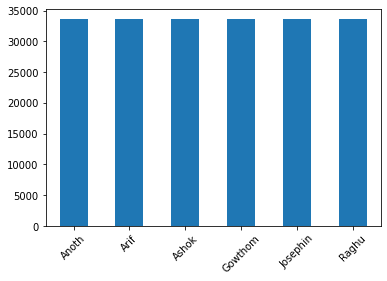

In [51]:
print("data class distribution after transformations...\n")
print(y.participant_name.value_counts())
print("\n")
y.participant_name.value_counts().plot(kind="bar")
plt.xticks(rotation=45)

data class distribution after transformations...

pattern3    33660
pattern6    33660
pattern1    33660
pattern4    33660
pattern2    33660
pattern5    33660
Name: pattern_name, dtype: int64




(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

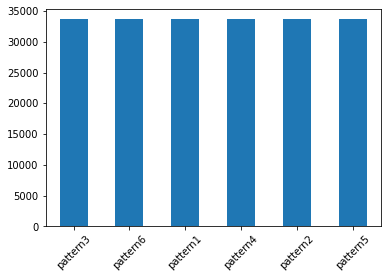

In [52]:
print("data class distribution after transformations...\n")
print(X.pattern_name.value_counts())
print("\n")
X.pattern_name.value_counts().plot(kind="bar")
plt.xticks(rotation=45)

In [53]:
# encode pattern_name using LabelEncoder()

pattern_encoder = LabelEncoder()

encoded_patterns = pattern_encoder.fit_transform(X.pattern_name)
print({k:v for k, v in zip(pattern_encoder.classes_.tolist(), set(encoded_patterns))})

{'pattern1': 0, 'pattern2': 1, 'pattern3': 2, 'pattern4': 3, 'pattern5': 4, 'pattern6': 5}


In [54]:
X["pattern_id"] = encoded_patterns
X.reset_index(inplace=True)
del X["index"]
X

,series_id,pattern_name,trace_difference,pupil_dilation,pattern_id
0,0,pattern3,0.035220,0.415510,2
1,0,pattern3,0.037450,0.415563,2
2,0,pattern3,0.039679,0.415615,2
3,0,pattern3,0.041909,0.415668,2
4,0,pattern3,0.044138,0.415720,2
...,...,...,...,...,...
201955,539,pattern4,-1.252073,0.403901,3
201956,539,pattern4,-1.216365,0.397873,3
201957,539,pattern4,-1.180656,0.391619,3
201958,539,pattern4,-1.144948,0.385364,3


#### PATTERN DEPENDANT CLASSIFIER

In [55]:
# get only samples for one patternI

is_pattern2 =  X['pattern_name']=="pattern2"
is_pattern3 =  X['pattern_name']=="pattern3"

# filter rows for year 2002 using  the boolean variable
X_pattern2 = X[is_pattern2]
X_pattern3 = X[is_pattern3]

In [56]:
X_pattern2

,series_id,pattern_name,trace_difference,pupil_dilation,pattern_id
2244,6,pattern2,-0.284603,-0.008666,1
2245,6,pattern2,-0.284532,-0.010614,1
2246,6,pattern2,-0.284462,-0.012562,1
2247,6,pattern2,-0.284391,-0.014510,1
2248,6,pattern2,-0.284320,-0.016458,1
...,...,...,...,...,...
200085,534,pattern2,-0.755013,-0.060770,1
200086,534,pattern2,-0.757090,-0.060732,1
200087,534,pattern2,-0.759167,-0.060694,1
200088,534,pattern2,-0.761244,-0.060655,1


In [57]:
y_pattern3 = y.iloc[X_pattern3.index.tolist()]
y_pattern2 = y.iloc[X_pattern2.index.tolist()]
y_pattern2

,series_id,participant_name
2244,6,Anoth
2245,6,Anoth
2246,6,Anoth
2247,6,Anoth
2248,6,Anoth
...,...,...
200085,534,Raghu
200086,534,Raghu
200087,534,Raghu
200088,534,Raghu


In [58]:
X = X_pattern2

In [59]:
del X['pattern_name']
del X['pattern_id']
X

,series_id,trace_difference,pupil_dilation
2244,6,-0.284603,-0.008666
2245,6,-0.284532,-0.010614
2246,6,-0.284462,-0.012562
2247,6,-0.284391,-0.014510
2248,6,-0.284320,-0.016458
...,...,...,...
200085,534,-0.755013,-0.060770
200086,534,-0.757090,-0.060732
200087,534,-0.759167,-0.060694
200088,534,-0.761244,-0.060655


In [60]:
y = y_pattern2
y

,series_id,participant_name
2244,6,Anoth
2245,6,Anoth
2246,6,Anoth
2247,6,Anoth
2248,6,Anoth
...,...,...
200085,534,Raghu
200086,534,Raghu
200087,534,Raghu
200088,534,Raghu


In [61]:
FEATURE_COLUMNS = X.columns.tolist()[1:]
FEATURE_COLUMNS

['trace_difference', 'pupil_dilation']

In [62]:
# encode labels: participant_name

label_encoder = LabelEncoder()

encoded_labels = label_encoder.fit_transform(y.participant_name)
print({k:v for k, v in zip(label_encoder.classes_.tolist(), set(encoded_labels))})

{'Anoth': 0, 'Arif': 1, 'Ashok': 2, 'Gowthom': 3, 'Josephin': 4, 'Raghu': 5}


In [63]:
y["label"] = encoded_labels
y.reset_index(inplace=True)
del y["index"]
y

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,series_id,participant_name,label
0,6,Anoth,0
1,6,Anoth,0
2,6,Anoth,0
3,6,Anoth,0
4,6,Anoth,0
...,...,...,...
33655,534,Raghu,5
33656,534,Raghu,5
33657,534,Raghu,5
33658,534,Raghu,5


In [64]:
# train, val, test split stratifies (balanced)

targets = []
data = []
for series_id, group in X.groupby("series_id"):
  sequence_features = group[FEATURE_COLUMNS]
  label = y[y.series_id == series_id].iloc[0].label  # all series would have same label so just take one
  data.append(sequence_features)
  targets.append(label)

train_sequences, test_sequences, ytrain, ytest= train_test_split(data, targets, test_size=0.2, random_state = 42, stratify=targets)
train_sequences, val_sequences, ytrain, yval = train_test_split(train_sequences, ytrain, test_size=0.2, random_state = 42, stratify=ytrain)

train_sequences = [(sequence, label) for sequence, label in zip(train_sequences, ytrain)]
test_sequences = [(sequence, label) for sequence, label in zip(test_sequences, ytest)]
val_sequences = [(sequence, label) for sequence, label in zip(val_sequences, yval)]

print("train, val, test")
len(train_sequences), len(val_sequences), len(test_sequences)

train, val, test


(57, 15, 18)

In [65]:
class UserDataset(Dataset):

  def __init__(self, sequences) -> None:
    super().__init__()
    self.sequences = sequences

  def __len__(self):
    return len(self.sequences)

  def __getitem__(self, idx):
    sequence, label = self.sequences[idx]
    return dict(
        sequence=torch.Tensor(sequence.to_numpy()),
        labels=torch.tensor(label).long()
    )
  def pad_sequences(self):
    pass

In [66]:
print("cpu_count: ", cpu_count())

class UserDataModule(pl.LightningDataModule):

  def __init__(self, train_sequences, test_sequences, val_sequences, batch_size):
    super().__init__()
    self.train_sequences = train_sequences
    self.test_sequences = test_sequences
    self.val_sequences = val_sequences
    self.batch_size = batch_size

  def setup(self, stage=None):
    self.train_dataset = UserDataset(self.train_sequences)
    self.test_dataset = UserDataset(self.test_sequences)
    self.val_dataset = UserDataset(self.val_sequences)

  def train_dataloader(self):
    return DataLoader(
        self.train_dataset,
        batch_size = self.batch_size,
        shuffle=True,
        num_workers=cpu_count()
    )

  def val_dataloader(self):
    return DataLoader(
        self.val_dataset,
        batch_size = self.batch_size,
        shuffle=False,
        num_workers=cpu_count()
    )

  def test_dataloader(self):
    return DataLoader(
        self.test_dataset,
        batch_size = self.batch_size,
        shuffle=False,
        num_workers=cpu_count()
    ) 

cpu_count:  2


In [67]:
N_EPOCHS = 1000
BATCH_SIZE = 16

data_module = UserDataModule(train_sequences, test_sequences, val_sequences, BATCH_SIZE)

In [68]:
# model

class SequenceModel(nn.Module):

  def __init__(self, n_features, n_classes, n_hidden=256, n_layers=3):
    super().__init__()
    # self.n_hidden = n_hidden
    self.lstm = nn.LSTM(
        input_size=n_features,
        hidden_size = n_hidden,
        num_layers=n_layers,
        batch_first = True,
        dropout=0.75   # hyperparameter for regularization
    )
    self.classifier = nn.Linear(n_hidden, n_classes)

  def forward(self, x):
    self.lstm.flatten_parameters()  # for multi_gpu purposes
    _, (hidden, _) = self.lstm(x)
    out = hidden[-1]
    return self.classifier(out)

In [69]:
class UserPredictor(pl.LightningModule):

  def __init__(self, n_features:int, n_classes:int):
    super().__init__()
    self.model = SequenceModel(n_features, n_classes)
    self.criterion = nn.CrossEntropyLoss()

  def forward(self, x, labels=None):
    output = self.model(x)
    loss = 0
    if labels is not None:
      loss = self.criterion(output, labels)
    return loss, output

  def training_step(self, batch, batch_idx):
    sequences = batch["sequence"]
    labels = batch["labels"]
    loss, outputs = self(sequences, labels)
    predictions = torch.argmax(outputs, dim=1)
    step_accuracy = accuracy(predictions, labels)

    self.log("train_loss", loss, prog_bar=True, logger=True)
    self.log("train_accuracy", step_accuracy, prog_bar=True, logger=True)
    return {"loss": loss, "accuracy": step_accuracy}

  def validation_step(self, batch, batch_idx):
    sequences = batch["sequence"]
    labels = batch["labels"]
    loss, outputs = self(sequences, labels)
    predictions = torch.argmax(outputs, dim=1)
    step_accuracy = accuracy(predictions, labels)
    
    self.log("val_loss", loss, prog_bar=True, logger=True)
    self.log("val_accuracy", step_accuracy, prog_bar=True, logger=True)
    return {"loss": loss, "accuracy": step_accuracy}

  def test_step(self, batch, batch_idx):
    print("test step...")
    sequences = batch["sequence"]
    labels = batch["labels"]
    loss, outputs = self(sequences, labels)
    predictions = torch.argmax(outputs, dim=1)
    step_accuracy = accuracy(predictions, labels)

    self.log("test_loss", loss, prog_bar=True, logger=True)
    self.log("test_accuracy", step_accuracy, prog_bar=True, logger=True)
    return {"loss": loss, "accuracy": step_accuracy}

  def configure_optimizers(self):
    return optim.Adam(self.parameters(), lr=0.0001)

In [70]:
model = UserPredictor(
    n_features=len(FEATURE_COLUMNS),
    n_classes=len(label_encoder.classes_)
)

In [71]:
# init tensorboar

# %load_ext tensorboard
# %tensorboard --logdir ./logs

In [72]:
checkpoint_callback = ModelCheckpoint(
    dirpath= "checkpoints",
    filename= "best-checkpoint",
    save_top_k=1,
    verbose= False,
    monitor="val_loss",
    mode="min"
)

logger = TensorBoardLogger("logs", name="usergaze")

trainer = pl.Trainer(
    logger = logger,
    callbacks=checkpoint_callback,
    max_epochs=N_EPOCHS,
    accelerator="gpu",  # gpu
    devices=1,
    enable_progress_bar=True,
    log_every_n_steps=1
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [73]:
# !wget -O mini.sh https://repo.anaconda.com/miniconda/Miniconda3-py39_4.9.2-Linux-x86_64.sh
# !chmod +x mini.sh
# !bash ./mini.sh -b -f -p /usr/local
# !conda install -q -y jupyter
# !conda install -q -y google-colab -c conda-forge
# !python -m ipykernel install --name "py39" --user

--2022-08-11 11:09:24--  https://repo.anaconda.com/miniconda/Miniconda3-py39_4.9.2-Linux-x86_64.sh
Resolving repo.anaconda.com (repo.anaconda.com)... 104.16.131.3, 104.16.130.3, 2606:4700::6810:8303, ...
Connecting to repo.anaconda.com (repo.anaconda.com)|104.16.131.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 61451533 (59M) [application/x-sh]
Saving to: ‘mini.sh’

mini.sh             100%[===================>]  58.60M   257MB/s    in 0.2s    

2022-08-11 11:09:25 (257 MB/s) - ‘mini.sh’ saved [61451533/61451533]

PREFIX=/usr/local
Unpacking payload ...
Solving environment: \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ failed with initial frozen solve. Retrying with flexible solve.
Solving environment: / - \ | / - \ | / - \ | / - \ | / - failed with repodata from current_repodata.json, will retry with next repodata source.
Solving environment: - \ | / - \ 

In [74]:
environ['WANDB_CONSOLE'] = 'off'
trainer.fit(model, data_module)

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:616: UserWarning:

Checkpoint directory /content/checkpoints exists and is not empty.

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type             | Params
-----------------------------------------------
0 | model     | SequenceModel    | 1.3 M 
1 | criterion | CrossEntropyLoss | 0     
-----------------------------------------------
1.3 M     Trainable params
0         Non-trainable params
1.3 M     Total params
5.282     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1000` reached.


In [80]:
from tensorboard import notebook
notebook.list()

No known TensorBoard instances running.


In [76]:
# notebook.display(port=6006, height=1000)

In [81]:
!tensorboard dev upload --logdir ./logs --name Hierachical_Multivariate_TimeSeries_Classification --one_shot

# 4/1AdQt8qiEllZ4YubRed1cRNDJXTyXv13W9MPySPPPuu6URp_PMZRA9t7qCyk


New experiment created. View your TensorBoard at: https://tensorboard.dev/experiment/TJbyqGmoRhyAxtjym9t6NQ/

[2022-08-11T11:35:00] Started scanning logdir.
[2022-08-11T11:35:09] Total uploaded: 30006 scalars, 0 tensors, 0 binary objects
[2022-08-11T11:35:09] Done scanning logdir.


Done. View your TensorBoard at https://tensorboard.dev/experiment/TJbyqGmoRhyAxtjym9t6NQ/


In [82]:
trainer.test(model, data_module)  
# data_module overall accuracy

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

test step...
test step...
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
      test_accuracy         0.3888888955116272
        test_loss           2.9228334426879883
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


[{'test_accuracy': 0.3888888955116272, 'test_loss': 2.9228334426879883}]

In [83]:
trained_model = UserPredictor.load_from_checkpoint(
    trainer.checkpoint_callback.best_model_path,   # trainer.checkpoint_callback.best_model_path, ./checkpoints/best-checkpoint-v5.ckpt
    n_features=len(FEATURE_COLUMNS),
    n_classes=len(label_encoder.classes_)
)

trained_model.freeze()

In [84]:
test_dataset = UserDataset(test_sequences)

predictions = []
labels = []

for item in tqdm(test_dataset):
  sequence = item["sequence"]
  label = item["labels"]

  _, output = trained_model(sequence.unsqueeze(dim=0))
  prediction = torch.argmax(output, dim=1)
  predictions.append(prediction.item())
  labels.append(label.item())

100%|██████████| 18/18 [00:01<00:00, 14.07it/s]


In [85]:
print(classification_report(labels, predictions, target_names=label_encoder.classes_))

              precision    recall  f1-score   support

       Anoth       0.50      0.33      0.40         3
        Arif       0.40      0.67      0.50         3
       Ashok       0.25      0.67      0.36         3
     Gowthom       0.00      0.00      0.00         3
    Josephin       0.00      0.00      0.00         3
       Raghu       0.50      0.33      0.40         3

    accuracy                           0.33        18
   macro avg       0.27      0.33      0.28        18
weighted avg       0.28      0.33      0.28        18



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [86]:
cm = confusion_matrix(labels, predictions)
df_cm = pd.DataFrame(
    cm, index=label_encoder.classes_, columns=label_encoder.classes_
)
df_cm

,Anoth,Arif,Ashok,Gowthom,Josephin,Raghu
Anoth,1,2,0,0,0,0
Arif,0,2,1,0,0,0
Ashok,1,0,2,0,0,0
Gowthom,0,0,2,0,0,1
Josephin,0,0,2,1,0,0
Raghu,0,1,1,0,0,1


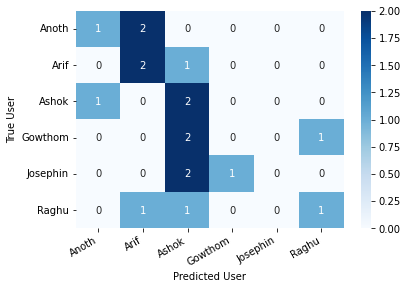

In [87]:
show_confusion_matrix(df_cm)

In [88]:
# in practice the user would only need a binary classifier, telling "yes this is the users gaze.." or "no, there is someone else doing this"